<a href="https://colab.research.google.com/github/MatteoRigoni/MachineLearningPlayground/blob/master/DeepLearning_ToxicCommentsFilter_MatteoRigoni_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Costruire un modello in grado di filtrare i commenti degli utenti in base al grado di dannosità del linguaggio:
1. Preprocessare il testo eliminando l'insieme di token che non danno contributo significativo a livello semantico
2. Trasformare il corpus testuale in sequenze
3. Costruire un modello di Deep Learning comprendente dei layer ricorrenti per un task di classificazione multilabel
4. In prediction time, il modello deve ritornare un vettore contenente un 1 o uno 0 in corrispondenza di ogni label presente nel dataset (toxic,	severe_toxic,	obscene,	threat,	insult,	identity_hate). In questo modo, un commento non dannoso sarà classificato da un vettore di soli 0 [0,0,0,0,0,0]. Al contrario, un commento pericoloso presenterà almeno un 1 tra le 6 labels.

In [35]:
import warnings
warnings.filterwarnings("ignore")
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import tensorflow as tf
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

In [36]:
import pandas as pd
BASE_URL = "https://s3.eu-west-3.amazonaws.com/profession.ai/datasets/"
df = pd.read_csv(BASE_URL+"Filter_Toxic_Comments_dataset.csv")

RANDOM_SEED= 10

In [37]:
df.head(5)

,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,sum_injurious
0,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0,0
1,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0,0
2,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0,0
3,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0,0
4,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0,0


##Esplorazione del dataset

Il dataset è costituito da 159.571 osservazioni e non contiene dati mancanti.

Il dataset è fortemente sbilanciato, sono di più i commenti legittimi, se ne terrà nel caso non si ottenga uno score significativo.

Si osserva come il numero di commenti tossici è inversamente proporzionale all'aumentare del livello di *severity*.

Dalla correlazione si evince come molti commenti anomali, presentino più anomalie, in particolare *toxic*, *insult* e *obscene*.

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

In [39]:
df.describe()

,toxic,severe_toxic,obscene,threat,insult,identity_hate,sum_injurious
count,159571.000000,159571.000000,159571.000000,159571.000000,159571.000000,159571.000000,159571.000000
mean,0.095844,0.009996,0.052948,0.002996,0.049364,0.008805,0.219952
std,0.294379,0.099477,0.223931,0.054650,0.216627,0.093420,0.748260
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,6.000000


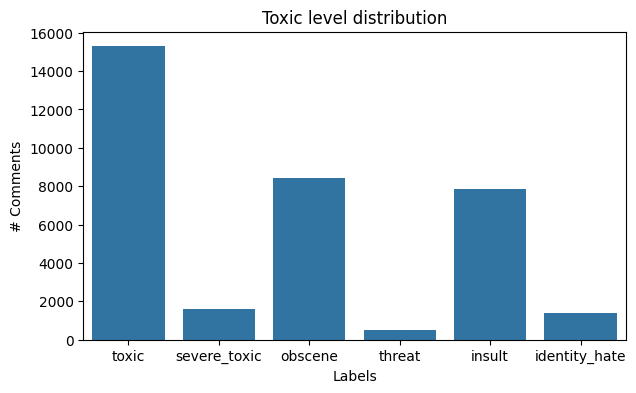

In [40]:
label_columns = ['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']
label_distribution = df[label_columns].sum()

plt.figure(figsize=(7,4))
sns.barplot(x=label_distribution.index, y=label_distribution.values)
plt.title('Toxic level distribution')
plt.xlabel('Labels')
plt.ylabel('# Comments')
plt.show()

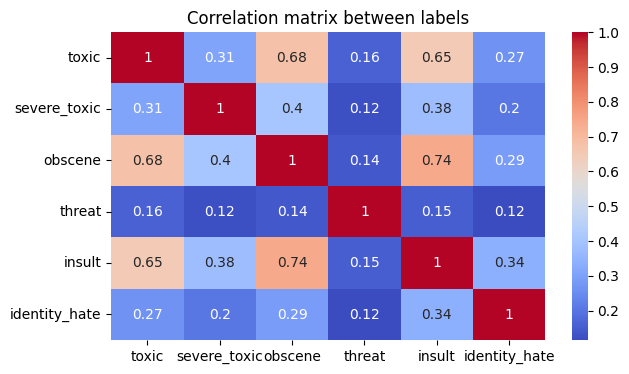

In [41]:
correlation_matrix = df[label_columns].corr()
plt.figure(figsize=(7,4))

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation matrix between labels')
plt.show()

⚠ Per via dei tempi di calcolo troppo elevati si lavora inizialmente solo su un sottoinsieme di osservazioni ⚠

In [77]:
#df_subset = df.head(100000)
df_subset = df

##Preprocessing dei commenti

In base ai valori osservati nel dataset, si decide di applicare una serie di trasformazioni sul testo, atte a semplificarlo, rimuovendo il superfluo.

*   Normalizzazione delle forme inglese contratte (es. can't = cannot, don't = do not)
*   Riporto di tutti i commenti in lower-case
*   Rimozione punteggiatura e caratteri non utili all'analisi. Dopo alcuni test, si decide di rimuovere anche le stop words (tipo gli articoli) che non sembrano apportare benefici allo score ottenuto.
*   Normalizzazione di parole per avere il "lemma", cioè la forma base della parola (es. playing = play)

>Fonti: https://medium.com/eni-digitalks/text-preprocessing-nlp-fundamentals-with-spacy-54f32e520bc8



In [ ]:
!pip install spacy
!pip install contractions
!python -m spacy download en_core_web_sm

import pandas as pd
import re
import spacy
import contractions
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from tqdm import tqdm

import nltk
nltk.download('stopwords')
nlp = spacy.load('en_core_web_sm')

In [79]:
def expand_contractions(text):
    return contractions.fix(text)

def to_lower_case(text):
    return text.lower()

def remove_irrilevant_chars(text):
    doc = nlp(text)
    return [token.text for token in doc if  not token.is_punct and not token.is_space and not token.is_stop]

def lemmatize_text(tokens):
    doc = nlp(' '.join(tokens))
    return [token.lemma_ for token in doc]

def preprocess_text(text):
    text = expand_contractions(text)
    text = to_lower_case(text)
    tokens = remove_irrilevant_chars(text)
    return lemmatize_text(tokens)

tqdm.pandas()
df_subset['clean_comment_text'] = df_subset['comment_text'].progress_apply(preprocess_text)
print(df_subset[['comment_text', 'clean_comment_text']].head())

100%|██████████| 159571/159571 [1:05:45<00:00, 40.44it/s]

                                        comment_text  \
0  Explanation\nWhy the edits made under my usern...   
1  D'aww! He matches this background colour I'm s...   
2  Hey man, I'm really not trying to edit war. It...   
3  "\nMore\nI can't make any real suggestions on ...   
4  You, sir, are my hero. Any chance you remember...   

                                  clean_comment_text  
0  [explanation, edit, username, hardcore, metall...  
1  [d'aww, match, background, colour, seemingly, ...  
2  [hey, man, try, edit, war, guy, constantly, re...  
3  [real, suggestion, improvement, wonder, sectio...  
4                [sir, hero, chance, remember, page]  


#Trasformazione del testo in sequenze

Si usa il *Tokenizer* per convertire il testo in sequenze, previa creazione del vocabolario con le frequenze delle parole (si prova con 20000)

Si applica poi il padding per avere le sequenze tutte della stessa lunghezza (si prova a basarsi sul 95° percentile).



In [80]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

VOCABOLARY_SIZE = 20000

In [81]:
tokenizer = Tokenizer(num_words=VOCABOLARY_SIZE)
tokenizer.fit_on_texts(df_subset['clean_comment_text'])
print(f"Number of distinct tokens: {len(tokenizer.word_index)}")

Number of distinct tokens: 206598


In [82]:
sequences = tokenizer.texts_to_sequences(df_subset['clean_comment_text'])
print(f"Sample comment: {df_subset['clean_comment_text'].iloc[0]}")
print(f"Sample sequence: {sequences[0]}")

Sample comment: ['explanation', 'edit', 'username', 'hardcore', 'metallica', 'fan', 'revert', 'vandalism', 'closure', 'gas', 'vote', 'new', 'york', 'dolls', 'fac', 'remove', 'template', 'talk', 'page', 'retire', 'now.89.205.38.27']
Sample sequence: [394, 5, 431, 3403, 8973, 628, 49, 99, 4917, 1889, 385, 44, 897, 2011, 26, 149, 4, 2, 2075]


In [83]:
max_length = int(np.percentile([len(seq) for seq in sequences], 90))
padded_sequences = pad_sequences(sequences, maxlen=max_length, padding='post')
print(f"Sample sequence with padding:\n {padded_sequences[0]}")

Sample sequence with padding:
 [ 394    5  431 3403 8973  628   49   99 4917 1889  385   44  897 2011
   26  149    4    2 2075    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


#Suddivisione dataset in train, test e validation

Nella fase di split, si salvano anche i commenti originali dei vari set, in modo tale da poterli poi usare nell'ultimo step di predizione.

Si prova anche a fare un undersampling dei commenti non tossici, in quanto il dataset è troppo sbilanciato.

In [84]:
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

In [85]:
def print_label_distribution(y):
    unique, counts = np.unique(y.sum(axis=1), return_counts=True)
    print(f"Distribution of labels into set: {dict(zip(unique, counts))}")

def balance_training_set(x_train, y_train, train_texts):
    all_zero_indices = np.where(y_train.sum(axis=1) == 0)[0]
    non_zero_indices = np.where(y_train.sum(axis=1) > 0)[0]

    n_samples = min(len(all_zero_indices), len(non_zero_indices))

    all_zero_indices_balanced = np.random.choice(all_zero_indices, n_samples, replace=False)
    non_zero_indices_balanced = np.random.choice(non_zero_indices, n_samples, replace=False)

    balanced_indices = np.concatenate([all_zero_indices_balanced, non_zero_indices_balanced])

    x_train_balanced = x_train[balanced_indices]
    y_train_balanced = y_train[balanced_indices]
    train_texts_balanced = train_texts[balanced_indices]

    return x_train_balanced, y_train_balanced, train_texts_balanced

In [86]:
x = padded_sequences
y = df_subset[label_columns].values

texts = df_subset['comment_text'].values

#stampa numero occorrenze per ogni label
unique, counts = np.unique(y.sum(axis=1), return_counts=True)
dict(zip(unique, counts))

x_train, x_temp, y_train, y_temp, train_texts, temp_texts = train_test_split(x, y, texts, test_size=0.3, random_state=RANDOM_SEED) #, stratify=y
x_val, x_test, y_val, y_test, val_texts, test_texts = train_test_split(x_temp, y_temp,  temp_texts, test_size=0.5, random_state=RANDOM_SEED)

# rus = RandomUnderSampler(random_state=42)
# X_train_resampled, y_train_resampled = rus.fit_resample(x_train, y_train)

x_train_balanced, y_train_balanced, train_texts_balanced = balance_training_set(x_train, y_train, train_texts)

print(f"Train block: {x_train_balanced.shape}, {y_train_balanced.shape}")
print(f"Validation block: {x_val.shape}, {y_val.shape}")
print(f"Test block: {x_test.shape}, {y_test.shape}")

print_label_distribution(y_train_balanced)

Train block: (22962, 64), (22962, 6)
Validation block: (23936, 64), (23936, 6)
Test block: (23936, 64), (23936, 6)
Distribution of labels into set: {0: 11481, 1: 4552, 2: 2461, 3: 2941, 4: 1247, 5: 260, 6: 20}


#Costruzione e addestramento del modello

Si costruisce un modello con layer ricorrenti, con il task di classificazione multi-label:

- Layer di Embedding: per trasformare gli input di testo in vettori densi di dimensione uguale
- Layer LSTM: per tenere conto delle dipendenze temporali nei dati sequenziali
- Dense Layer: Layer con un unità per ogni label, con funzione di attivazione sigmoidale

Dopo alcuni test, si decide di inserire un *Dropout* dopo ogni LSTM, per ridurre l'overfitting.

Si usa anche l'*Early Stopping* per interrompere il processo se non si notano miglioramenti dopo 3 passaggi.

In [87]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.utils import class_weight

EMBEDDING_SIZE= 100 #???

In [88]:
model = Sequential()
model.add(Embedding(input_dim=VOCABOLARY_SIZE, output_dim=EMBEDDING_SIZE, input_length=max_length))
model.add(LSTM(64, return_sequences=True))
model.add(Dropout(0.5))
model.add(LSTM(32))
model.add(Dropout(0.5))
model.add(Dense(6, activation='sigmoid'))

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

#non si applica la class_wieght in quanto si sono ottenuti risultati migliori splittando il dataset in partenza...
# class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train_balanced.flatten()), y=y_train_balanced.flatten())
# class_weights_dict = dict(enumerate(class_weights))
# print("Class Weights:", class_weights_dict)
# history = model.fit(x_train_balanced, y_train_balanced, batch_size=32, epochs=20, validation_data=(x_val, y_val), class_weight=class_weights_dict),  callbacks=[early_stopping])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = model.fit(x_train_balanced, y_train_balanced, batch_size=32, epochs=6, validation_data=(x_val, y_val),  callbacks=[early_stopping])

model.summary()

Epoch 1/6
718/718 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - accuracy: 0.8100 - loss: 0.4163 - val_accuracy: 0.9944 - val_loss: 0.2354
Epoch 2/6
718/718 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.9595 - loss: 0.3427 - val_accuracy: 0.9944 - val_loss: 0.1768
Epoch 3/6
718/718 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.9673 - loss: 0.3065 - val_accuracy: 0.9944 - val_loss: 0.1430
Epoch 4/6
718/718 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.9683 - loss: 0.2745 - val_accuracy: 0.9944 - val_loss: 0.0974
Epoch 5/6
718/718 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.9654 - loss: 0.2117 - val_accuracy: 0.9944 - val_loss: 0.0750
Epoch 6/6
718/718 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.9534 - loss: 0.1854 - val_accuracy: 0.9944 - val_loss: 0.0761


Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_7 (Embedding)              │ (None, 64, 100)             │       2,000,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_16 (LSTM)                       │ (None, 64, 64)              │          42,240 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_16 (Dropout)                 │ (None, 64, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_17 (LSTM)                       │ (None, 32)                  │          12,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_17 (Dropout)                 │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 6)                   │             198 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,164,564 (23.52 MB)

 Trainable params: 2,054,854 (7.84 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 4,109,710 (15.68 MB)

#Valutazione performance modello

L'accuracy ottenuta sul test set è molto alta, prossima al 100%.

Si stampano anche grafici per vedere la variazione della loss e dell'accuracy durante le varie epoche.

In [89]:
import matplotlib.pyplot as plt

748/748 - 3s - 3ms/step - accuracy: 0.9950 - loss: 0.0746
Loss: 0.0745798796415329
Accuracy: 0.9950284361839294


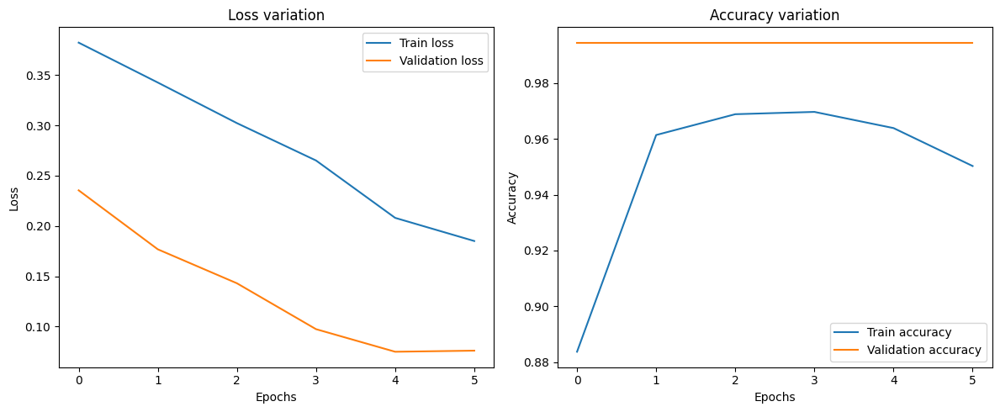

In [90]:
loss, accuracy = model.evaluate(x_test, y_test, verbose=2)
print(f"Loss: {loss}")
print(f"Accuracy: {accuracy}")

_, (plt1, plt2) = plt.subplots(1, 2, figsize=(12, 5))

plt1.plot(history.history['loss'], label='Train loss')
plt1.plot(history.history['val_loss'], label='Validation loss')
plt1.set_xlabel('Epochs')
plt1.set_ylabel('Loss')
plt1.legend()
plt1.set_title('Loss variation')

plt2.plot(history.history['accuracy'], label='Train accuracy')
plt2.plot(history.history['val_accuracy'], label='Validation accuracy')
plt2.set_xlabel('Epochs')
plt2.set_ylabel('Accuracy')
plt2.legend()
plt2.set_title('Accuracy variation')

plt.tight_layout()
plt.show()

#Verifica predizione del modello

Si effettua il predict sul modello di test, considerando i valori sopra lo 0.5 come positivi.

Si stampano poi in formato tabellare alcuni esempi con la predizione vs il valore reale, evidenziando in rosso quelli diversi.

Si stampano anche le confusion matrix per avere un idea di eventuali falsi positivi.

In [91]:
from IPython.display import display, HTML
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

In [92]:
def replace_newlines(text):
    return text.replace('\n', '<br>')

In [93]:
test_predictions = model.predict(x_test)

threshold = 0.5
test_pred_labels = (test_predictions > threshold).astype(int)

def color_diff_values(pred, real):
    color = 'green' if pred==real else 'red'
    return f"{pred} (<span style=' color:{color} '>{real}</span>)"

test_texts = [replace_newlines(text) for text in test_texts]

df_results = pd.DataFrame(
    {
    'Comment': test_texts,
    'Toxic': [color_diff_values(p, r) for p, r in zip(test_pred_labels[:, 0], y_test[:, 0])],
    'SevereToxic': [color_diff_values(p, r) for p, r in zip(test_pred_labels[:, 1], y_test[:, 1])],
    'Obscene': [color_diff_values(p, r) for p, r in zip(test_pred_labels[:, 2], y_test[:, 2])],
    'Threat': [color_diff_values(p, r) for p, r in zip(test_pred_labels[:, 3], y_test[:, 3])],
    'Insult': [color_diff_values(p, r) for p, r in zip(test_pred_labels[:, 4], y_test[:, 4])],
    'IdentityHate':  [color_diff_values(p, r) for p, r in zip(test_pred_labels[:, 5], y_test[:, 5])]
    }
 )

df_filtered = df_results

#per vedere comportamento su quelli tossici...
# df_filtered = df_results[
#     (df_results['Toxic'].str.contains('1')) |
#     (df_results['SevereToxic'].str.contains('1')) |
#     (df_results['Obscene'].str.contains('1')) |
#     (df_results['Threat'].str.contains('1')) |
#     (df_results['Insult'].str.contains('1')) |
#     (df_results['IdentityHate'].str.contains('1'))
# ]

if len(df_filtered) > 10:
    df_filtered_sample = df_filtered.sample(n=10, random_state=RANDOM_SEED)
else:
    df_filtered_sample = df_filtered

styled_html = f"""
<style>
    table {{ width: 100%; }}
    th:first-child, td:first-child {{ max-width: 50%; word-wrap: break-word; }}
</style>
{df_filtered.to_html(escape=False)}
"""

display(HTML(styled_html))

748/748 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step


,Comment,Toxic,SevereToxic,Obscene,Threat,Insult,IdentityHate
0,As i said before...abt 300 yrs back the nairs didnt have their own land..they were tenants of the namboodiris and fought for them as well...during times of peace they would serve the namboodiris and tht is wht i mean by sudroid jobs,0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
1,two reversions on Hezbollah Could you explain on the talk page why you have reverted my edit twice?,0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
2,"As for the first formula, if you mean this: , this is not what I keyed in, and further confirmation may be required. )",0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
3,"Doc James and Ozzie: I confess I am curious how on earth you manage to make large numbers of changes within minutes. Do you have a team working for you?Secondly, although I am not entirely happy with the strong medical vs biological emphasis, I think the article overall is better now - can you upgrade its rating?And I think we can now remove the warning that the references are poor.",0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
4,"Chinese fan dance There doesn't seem to be any articles on the Chinese traditional fan dance. Do you know of any? (talk) 20:54, 27 Feb 2005 (UTC)",0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
5,"Please sign to agree to formal mediation I have filled out a request for formal mediation after Mattisse rejected Blueboar's attempts. The link for the request in here: . Each party, in this case PalaceGuard and Mattisse, is required to sign near the end of the form and then fill out their general issues. You don't need to inundate the mediator with issues that are already discussed on the Talk pages, and the request must first be accepted. -",0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
6,""" Should this be added? Should it be added on this page or the Great Britain page or both? -TC """,0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
7,what don't you understand about fair use? does it exist at all?,0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
8,"The book has it as 15 days; I assumed since it had 7 there, the movie had seven. I will change seven to two.",0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)
9,"""::Because it's not true? The thing you said I mean, which if you forgot, was the simple statement of a fact """"When it's closed as no consensus, there's no appeal"""". But maybe you're right, I'm learning fast that making stuff up doesn't earn any of the insiders here a block. Outsiders complaining about facts, they're the only people who get blocked here. Anyway, you carry on with whatever it is you're doing today, there must be lots more people out there who haven't understood consensus even though they've read the page and it doesn't match what they saw with their own eyes, that you can advise about their lack of any kind of recourse. """,0 (0),0 (0),0 (0),0 (0),0 (0),0 (0)


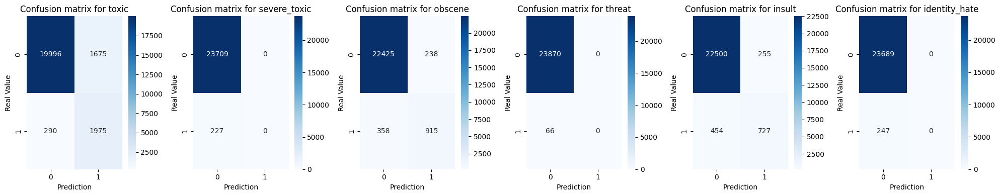

In [94]:
fig, axes = plt.subplots(1, 6, figsize=(20, 4))

for i, (label, ax) in enumerate(zip(label_columns, axes)):
    conf_matrix = confusion_matrix(y_test[:, i], test_pred_labels[:, i])
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f'Confusion matrix for {label}')
    ax.set_xlabel('Prediction')
    ax.set_ylabel('Real Value')

plt.tight_layout()
plt.show()

#Conclusioni

Il modello ha uno score generale buono, ma presente molti falsi positivi nei commenti "tossici".

Si sono fatti i seguenti test per cercare di ottenere un risultato migliore senza successo:
- Numero maggiore di epoche
- Numero maggiore di parole nel vocabolario
- Aumento del numero di neuroni e di layer
- Preprocessing più o meno aggressivo prima dell'addestramento